# Mount Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Importing Libraries

In [ ]:
import os
import random
import shutil
import glob
from IPython.display import Image, display
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import torch

# Dataset Details

In [ ]:
import os

# Define the folder path
folder_path = '/content/drive/MyDrive/MLR/S3R2-KIIT'
files = os.listdir(folder_path)

for file in files:
    print(file)

train
valid
test
S3R2_data.yml


In [ ]:
import os

# Define the paths for train, valid, and test directories
base_dir = '/content/drive/MyDrive/MLR/S3R2-KIIT'
dirs = ['train', 'valid', 'test']

for dir_name in dirs:
    dir_path = os.path.join(base_dir, dir_name)
    print(f"\nDirectory: {dir_name}")
    for subfolder in os.listdir(dir_path):
        subfolder_path = os.path.join(dir_path, subfolder)

        if os.path.isdir(subfolder_path):
            num_files = len([f for f in os.listdir(subfolder_path) if os.path.isfile(os.path.join(subfolder_path, f))])
            print(f"  Subfolder: {subfolder}, Number of files: {num_files}")



Directory: train
  Subfolder: images, Number of files: 1360
  Subfolder: labels, Number of files: 1360

Directory: valid
  Subfolder: images, Number of files: 170
  Subfolder: labels, Number of files: 170

Directory: test
  Subfolder: images, Number of files: 170
  Subfolder: labels, Number of files: 170


We need to change yml file path (ex. train: drive/MyDrive/MLR/S3R2-KIIT/train/images) information according to which location we stored the dataset in our drive.

In [ ]:
yaml_file_path = '/content/drive/MyDrive/MLR/S3R2-KIIT/S3R2_data.yml'
with open(yaml_file_path, 'r') as file:
    yaml_content = file.read()

print(yaml_content)


names:
  - Artilary
  - Missile
  - Radar
  - M. Rocket Launcher
  - Soldier
  - Tank
  - Vehicle
nc: 7
train: /content/drive/MyDrive/MLR/S3R2-KIIT/train/images
val: /content/drive/MyDrive/MLR/S3R2-KIIT/test/images
test: /content/drive/MyDrive/MLR/S3R2-KIIT/valid/images



Let's see the information of a annotation file...

In [ ]:
import os

label_dir = '/content/drive/MyDrive/MLR/S3R2-KIIT/test/labels'
label_file = 'image_s3r2_kiit_116.txt'

label_path = os.path.join(label_dir, label_file)

if not os.path.exists(label_path):
    print(f"Label file not found: {label_path}")
else:
    with open(label_path, 'r') as f:
        lines = f.readlines()

    print(f"Label file: {label_file}")
    for line in lines:
        class_id, x_center, y_center, width, height = map(float, line.strip().split())

        print(f"Class ID: {int(class_id)}")
        print(f"Bounding Box: x_center={x_center}, y_center={y_center}, width={width}, height={height}")
        print("-" * 50)

Label file: image_s3r2_kiit_116.txt
Class ID: 5
Bounding Box: x_center=0.41594, y_center=0.568333, width=0.35438, height=0.234259
--------------------------------------------------


In [ ]:
# Class names as per our dataset
class_names = [
    "Artilary",             # ID 0
    "Missile",              # ID 1
    "Radar",                # ID 2
    "M. Rocket Launcher",   # ID 3
    "Soldier",              # ID 4
    "Tank",                 # ID 5
    "Vehicle"               # ID 6
]

# Visualization

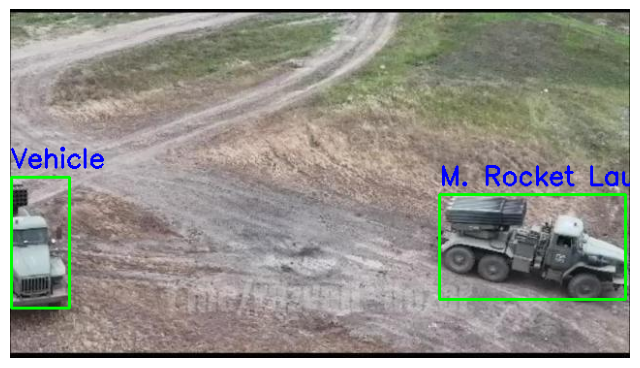

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt

# Class names as per your dataset
class_names = [
    "Artilary",             # ID 0
    "Missile",              # ID 1
    "Radar",                # ID 2
    "M. Rocket Launcher",   # ID 3
    "Soldier",              # ID 4
    "Tank",                 # ID 5
    "Vehicle"               # ID 6
]

image_dir = '/content/drive/MyDrive/MLR/S3R2-KIIT/test/images'
annotation_dir = '/content/drive/MyDrive/MLR/S3R2-KIIT/test/labels'

def visualize_image_with_annotations(image_name):
    image_path = os.path.join(image_dir, image_name)
    img = cv2.imread(image_path)

    if img is None:
        print(f"Image not found: {image_path}")
        return

    annotation_name = os.path.splitext(image_name)[0] + '.txt'
    annotation_path = os.path.join(annotation_dir, annotation_name)

    if not os.path.exists(annotation_path):
        print(f"Annotation not found: {annotation_path}")
        return

    img_height, img_width = img.shape[:2]

    with open(annotation_path, 'r') as f:
        lines = f.readlines()

    for line in lines:
        # Parse values and convert class_id to integer
        class_id, x_center, y_center, width, height = map(float, line.strip().split())
        class_id = int(class_id)  # Ensure class_id is an integer

        x_center = int(x_center * img_width)
        y_center = int(y_center * img_height)
        width = int(width * img_width)
        height = int(height * img_height)

        x_min = int(x_center - width / 2)
        y_min = int(y_center - height / 2)
        x_max = int(x_center + width / 2)
        y_max = int(y_center + height / 2)

        cv2.rectangle(img, (x_min, y_min), (x_max, y_max), color=(0, 255, 0), thickness=2)

        # Check if class_id is within bounds and retrieve class name
        if 0 <= class_id < len(class_names):
            class_name = class_names[class_id]
            cv2.putText(img, class_name, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)
        else:
            print(f"Class ID {class_id} is out of bounds for class names list.")

    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(8, 8))
    plt.imshow(img_rgb)
    plt.axis('off')
    plt.show()

visualize_image_with_annotations('image_s3r2_kiit_1297.jpeg')  # Image to Visualize


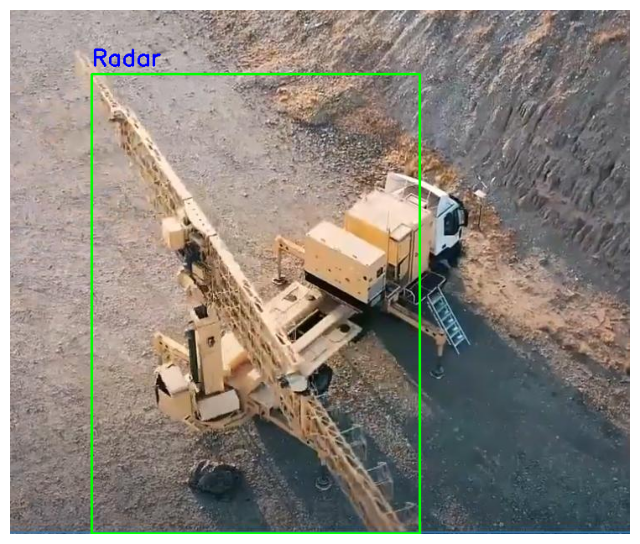

In [ ]:
visualize_image_with_annotations('image_s3r2_kiit_150.jpeg')

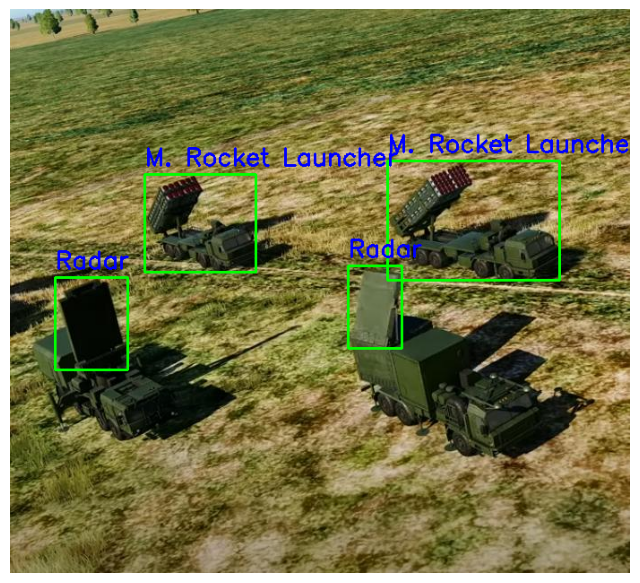

In [ ]:
visualize_image_with_annotations('image_s3r2_kiit_1591.jpeg')

# Cheking for GPU

In [ ]:
if torch.cuda.is_available():
    gpu_info = torch.cuda.get_device_properties(0)
    print(f"GPU is available: {gpu_info.name}")
    print(f"Total Memory: {gpu_info.total_memory / (1024**3):.2f} GB")
    print(f"CUDA Capability: {gpu_info.major}.{gpu_info.minor}")
else:
    print("GPU not available, running on CPU.")


GPU is available: Tesla T4
Total Memory: 14.75 GB
CUDA Capability: 7.5


In [ ]:
!nvidia-smi

Mon Nov  4 06:53:11 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   45C    P8               9W /  70W |      3MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

# Setting up YOLOV11-SMALL...

In [ ]:
%pip install ultralytics supervision roboflow
import ultralytics
ultralytics.checks()

Ultralytics 8.3.38 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 32.6/112.6 GB disk)


Using the YOLOv8_SMALL model

In [ ]:
!yolo task=detect mode=train model=/content/yolo11s.pt data=/content/drive/MyDrive/MLR/S3R2-KIIT/S3R2_data.yml epochs=100 imgsz=640 plots=True

100% 18.4M/18.4M [00:00<00:00, 183MB/s]
Ultralytics 8.3.27 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=/content/yolo11s.pt, data=/content/drive/MyDrive/MLR/S3R2-KIIT/S3R2_data.yml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save

# Saving the result

In [ ]:
from google.colab import drive
import shutil

source_path = '/content/runs'
destination_path = '/content/drive/MyDrive/MLR/Yolo11Small_output'
shutil.copytree(source_path, destination_path)

print(f"The `runs` folder has been copied to: {destination_path}")

The `runs` folder has been copied to: /content/drive/MyDrive/MLR/Yolo11Small_output


# Result Analysis

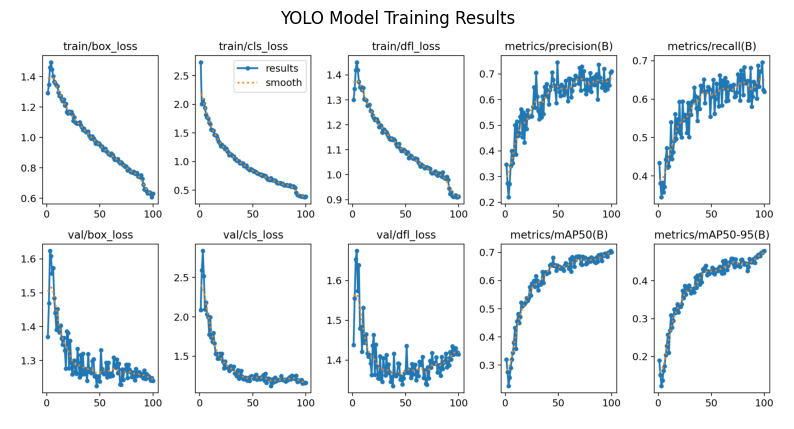

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Load and display the results image
results_image_path = '/content/drive/MyDrive/MLR/S3R2-KIIT_11SMALL/detect/train/results.png'
img = mpimg.imread(results_image_path)

plt.figure(figsize=(10, 6))
plt.imshow(img)
plt.axis('off')  # Hide axes
plt.title('YOLO Model Training Results')
plt.show()


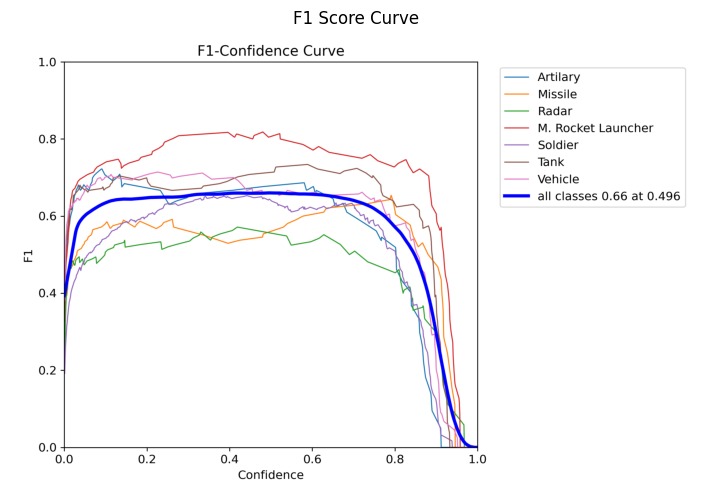

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Load and display the F1 curve image
f1_curve_path = '/content/drive/MyDrive/MLR/S3R2-KIIT_11SMALL/detect/train/F1_curve.png'
img = mpimg.imread(f1_curve_path)

plt.figure(figsize=(10, 6))
plt.imshow(img)
plt.axis('off')  # Hide axes
plt.title('F1 Score Curve')
plt.show()


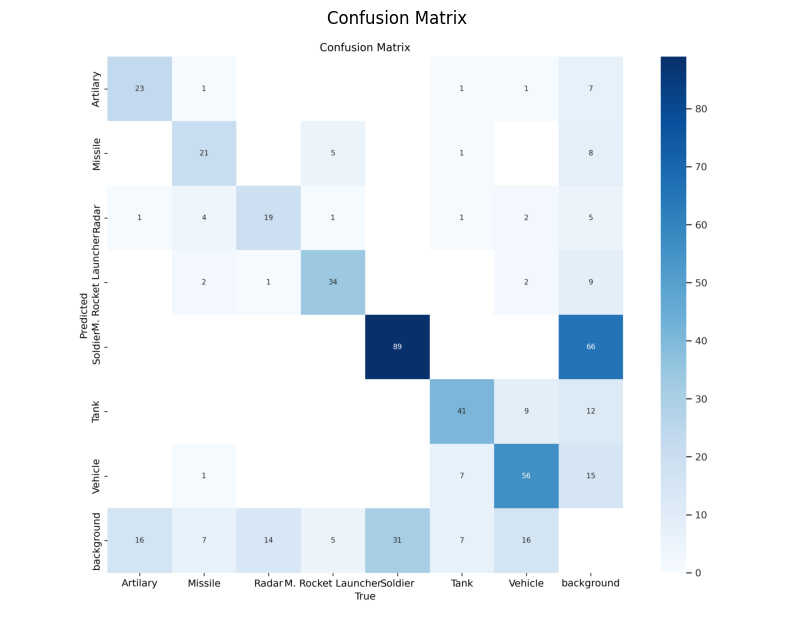

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Path to the confusion matrix image
image_path = '/content/drive/MyDrive/MLR/S3R2-KIIT_11SMALL/detect/train/confusion_matrix.png'

# Read and display the image
img = mpimg.imread(image_path)
plt.figure(figsize=(10, 8))
plt.imshow(img)
plt.axis('off')  # Hide the axes
plt.title('Confusion Matrix')
plt.show()


# Detection

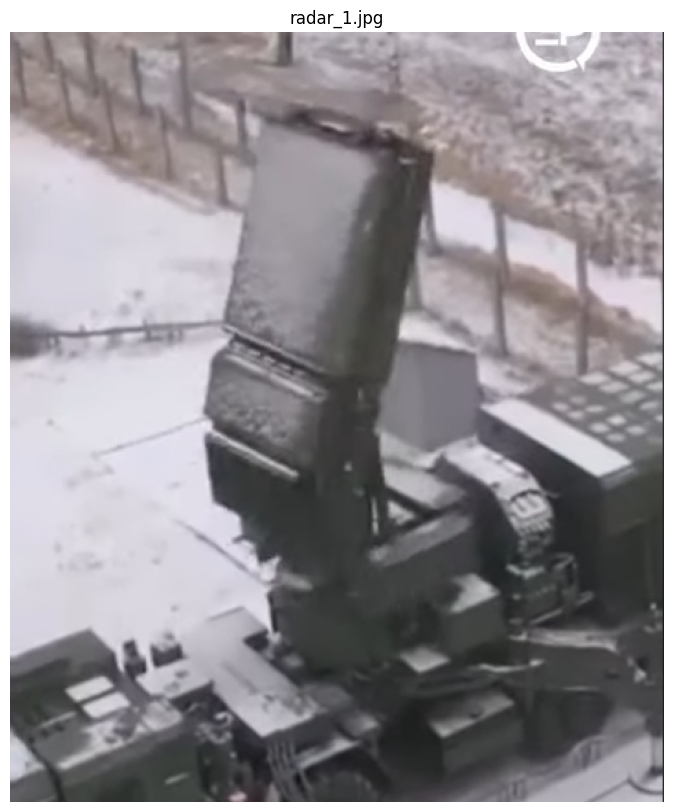

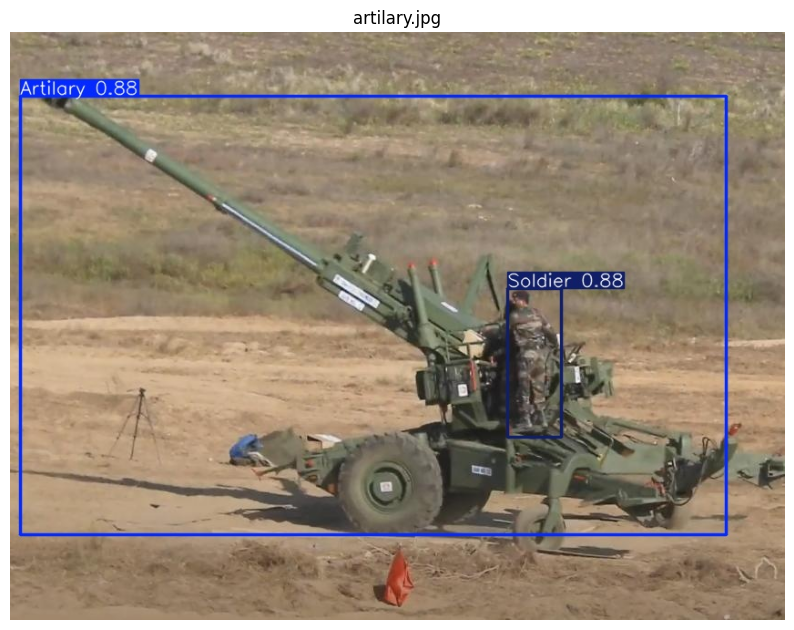

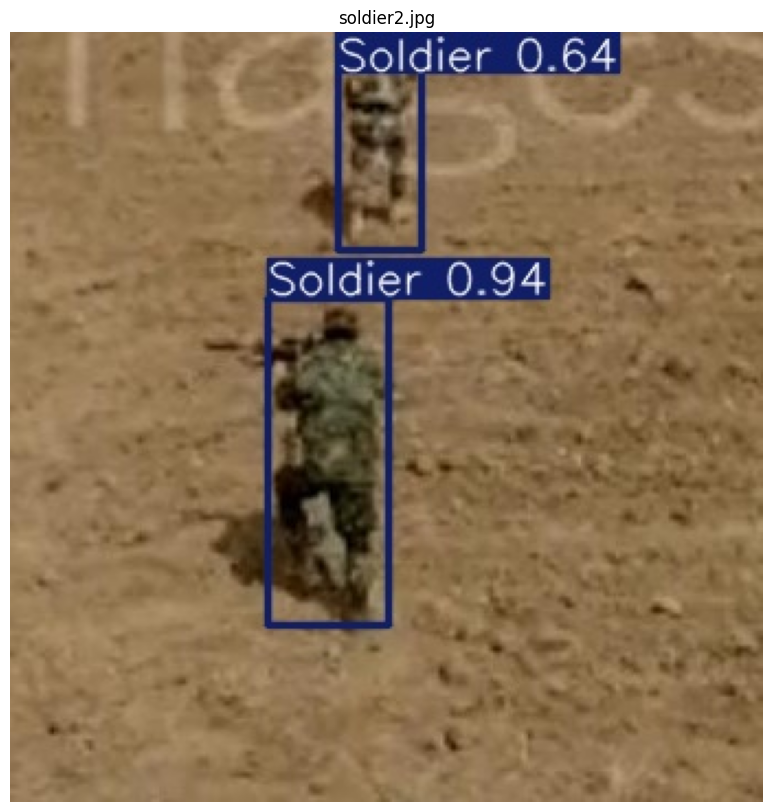

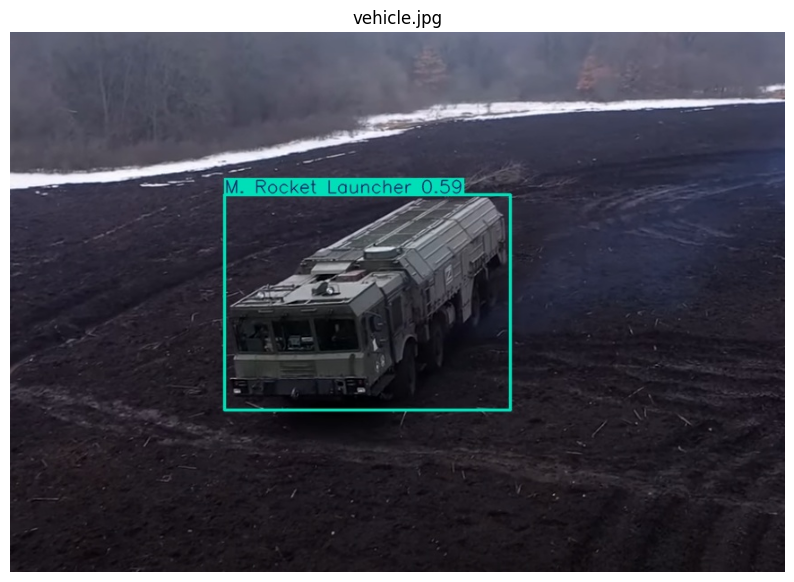

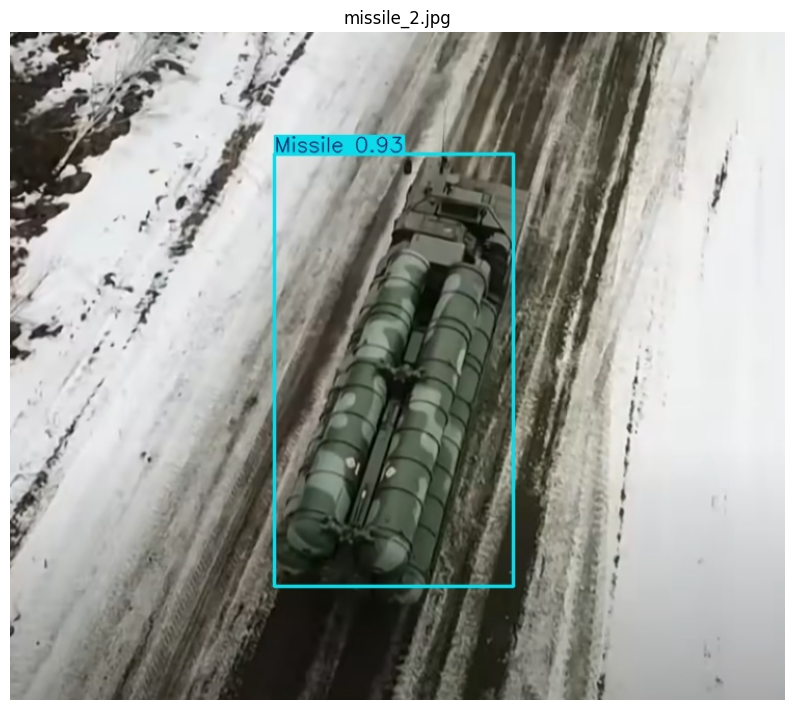

...

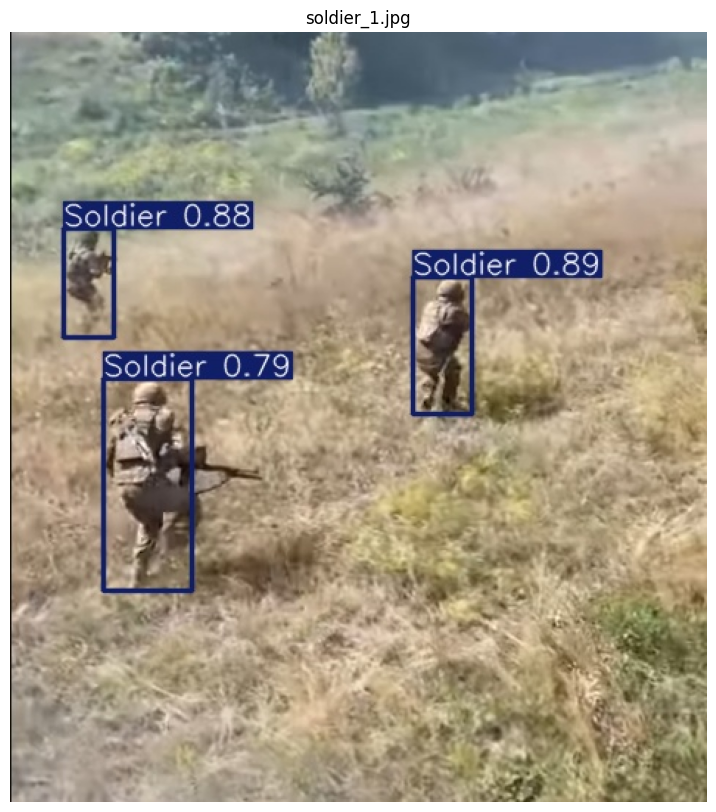

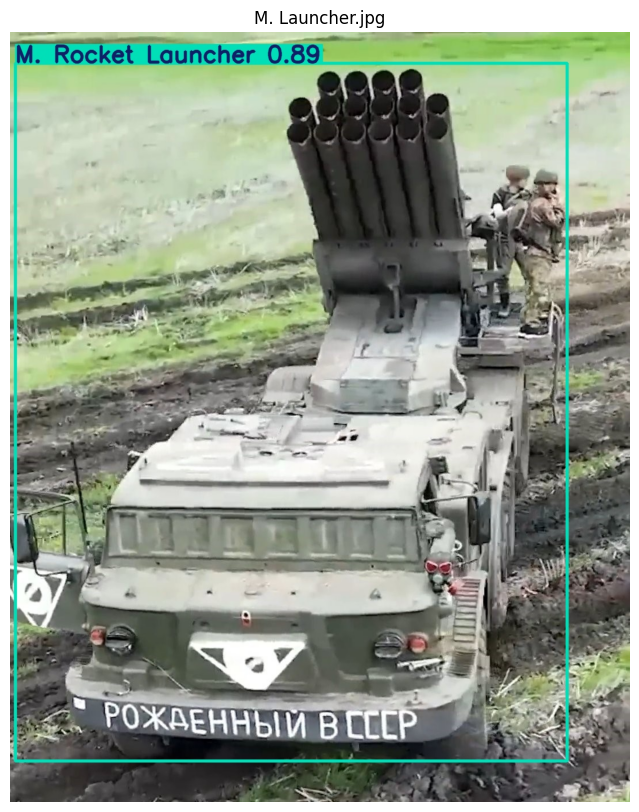

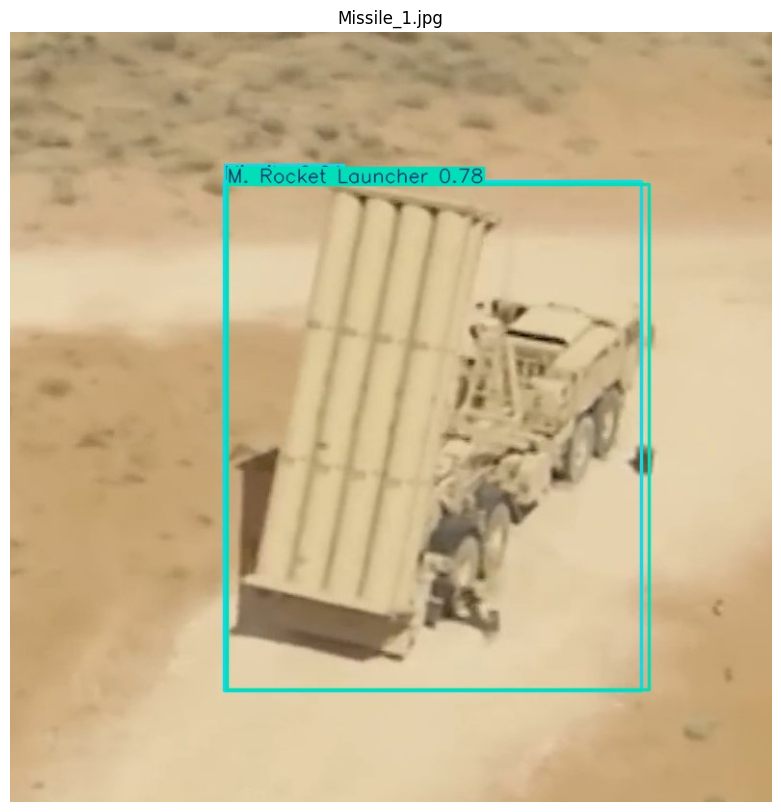

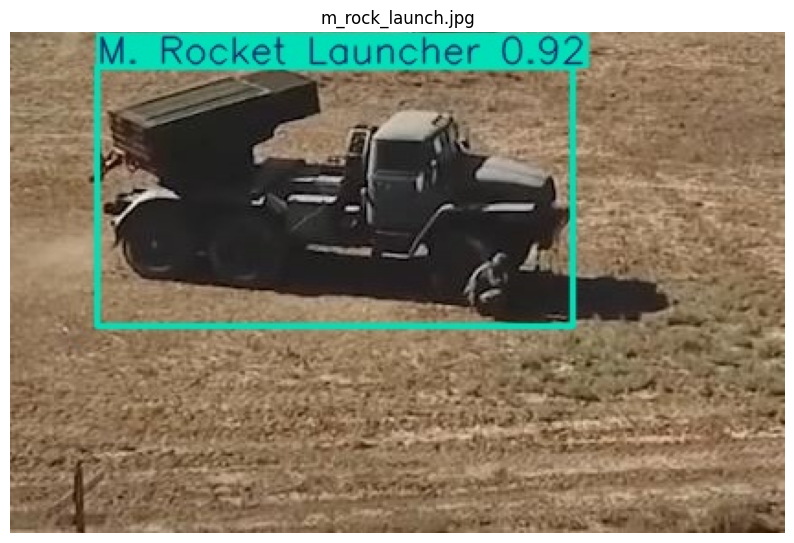

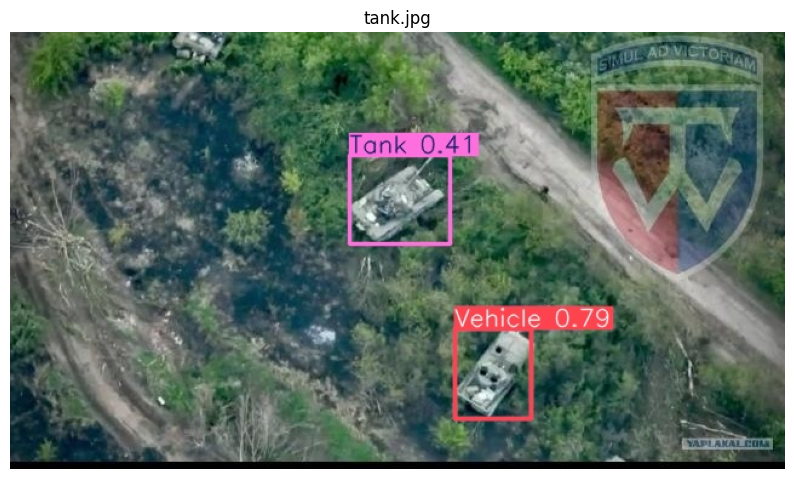

In [ ]:
import matplotlib.pyplot as plt
import cv2
import os

image_folder = 'runs/detect/predict4/'

image_files = [f for f in os.listdir(image_folder) if f.endswith(('.jpg', '.jpeg', '.webp'))]


for image_file in image_files:
    img_path = os.path.join(image_folder, image_file)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.title(image_file)
    plt.axis('off')
    plt.show()

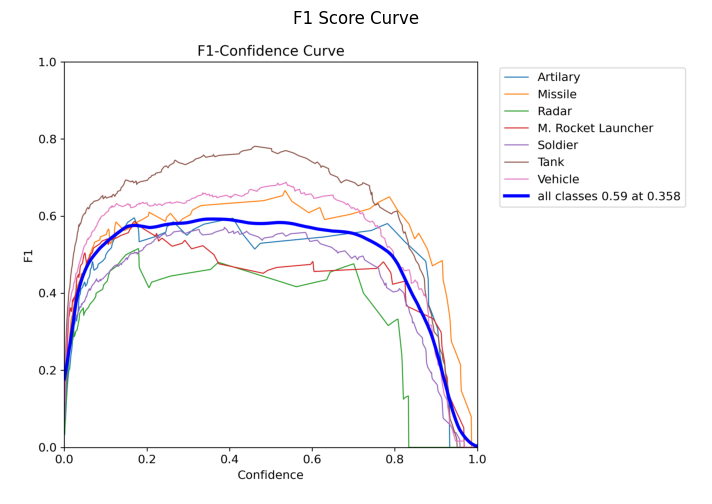

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Load and display the F1 curve image
f1_curve_path = '/content/runs/detect/train/F1_curve.png'
img = mpimg.imread(f1_curve_path)

plt.figure(figsize=(10, 6))
plt.imshow(img)
plt.axis('off')  # Hide axes
plt.title('F1 Score Curve')
plt.show()


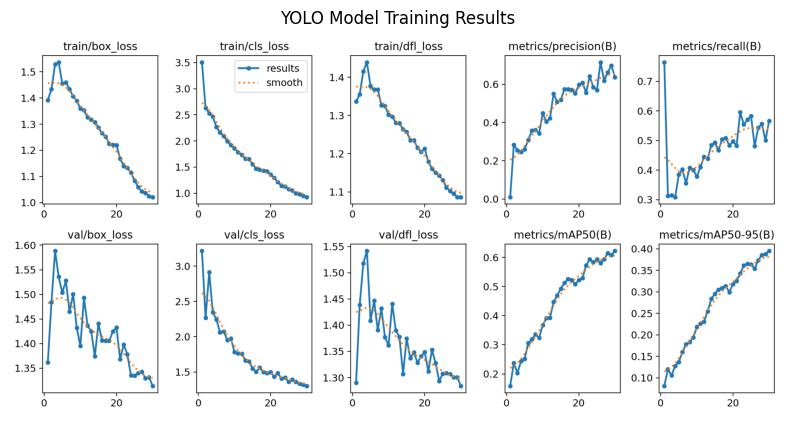

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Load and display the results image
results_image_path = '/content/runs/detect/train/results.png'
img = mpimg.imread(results_image_path)

plt.figure(figsize=(10, 6))
plt.imshow(img)
plt.axis('off')  # Hide axes
plt.title('YOLO Model Training Results')
plt.show()


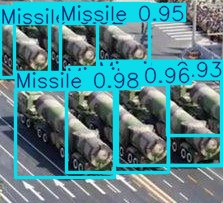

In [ ]:

#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/runs/detect/predict5/missile.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

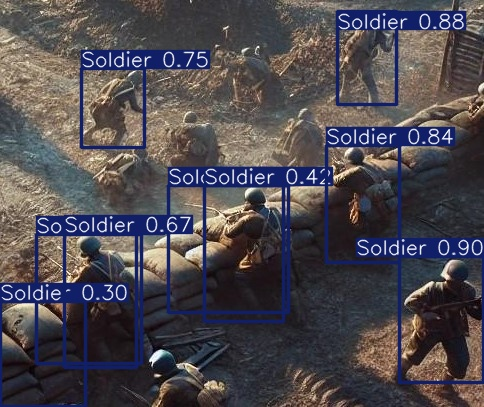

In [ ]:

#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/runs/detect/predict8/soldier.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

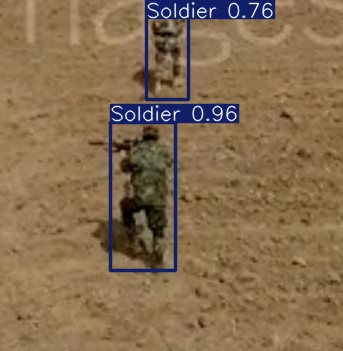

In [ ]:

#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/runs/detect/predict9/soldier2.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Tracking

In [ ]:
!git clone https://github.com/ultralytics/ultralytics
%cd ultralytics
!pip install -e .

Cloning into 'ultralytics'...
remote: Enumerating objects: 44999, done.
remote: Counting objects: 100% (436/436), done.
remote: Compressing objects: 100% (261/261), done.
remote: Total 44999 (delta 268), reused 279 (delta 175), pack-reused 44563 (from 1)
Receiving objects: 100% (44999/44999), 38.53 MiB | 18.27 MiB/s, done.
Resolving deltas: 100% (33378/33378), done.
/content/ultralytics
Obtaining file:///content/ultralytics
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
  Building editable for ultralytics (pyproject.toml) ... done
  Created wheel for ultralytics: filename=ultralytics-8.3.38-0.editable-py3-none-any.whl size=22679 sha256=f9dba1bfa8101b367cd4b4f3636d5f04bace6b61c455be3ef1efa005a84b9b63
  Stored in directory: /tmp/pip-ephem-wheel-cache-lgmaccc7/wheels/9a/cd/d5/95912172899f8ec640166ff6eef49156b1b00d6b2ade4a3cb1
Succ

In [ ]:
!yolo track model='/content/runs/detect/train/weights/best.pt' source='/content/downloaded_video7.mp4' save=True #'/content/good tank moving.mp4''/content/download.mp4'

Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,583,517 parameters, 0 gradients, 6.3 GFLOPs

video 1/1 (frame 1/652) /content/downloaded_video7.mp4: 640x384 (no detections), 46.0ms
video 1/1 (frame 2/652) /content/downloaded_video7.mp4: 640x384 (no detections), 9.1ms
video 1/1 (frame 3/652) /content/downloaded_video7.mp4: 640x384 (no detections), 8.2ms
video 1/1 (frame 4/652) /content/downloaded_video7.mp4: 640x384 (no detections), 8.0ms
video 1/1 (frame 5/652) /content/downloaded_video7.mp4: 640x384 1 Vehicle, 7.9ms
video 1/1 (frame 6/652) /content/downloaded_video7.mp4: 640x384 1 Vehicle, 13.4ms
video 1/1 (frame 7/652) /content/downloaded_video7.mp4: 640x384 3 Vehicles, 12.2ms
video 1/1 (frame 8/652) /content/downloaded_video7.mp4: 640x384 4 Vehicles, 17.1ms
video 1/1 (frame 9/652) /content/downloaded_video7.mp4: 640x384 2 Vehicles, 14.4ms
video 1/1 (frame 10/652) /content/downloaded_video7.mp4: 640x384 2 Vehicl

In [ ]:
!ffmpeg -i "/content/runs/detect/track5/downloaded_video7.avi" "/content/runs/detect/track5/downloaded_video7.mp4"


ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
from IPython.display import Video

# Display the converted video
Video('/content/runs/detect/track/good_tank_moving.mp4', embed=True)


In [ ]:
from IPython.display import Video

# Display the converted video
Video('/content/runs/detect/track3/downloaded_video3.mp4', embed=True)


In [ ]:
from IPython.display import Video

# Display the converted video
Video('/content/runs/detect/track4/downloaded_video5.mp4', embed=True)


In [ ]:
from IPython.display import Video

# Display the converted video
Video('/content/runs/detect/track5/downloaded_video7.mp4', embed=True)


In [ ]:
from IPython.display import Video

# Display the converted video
Video('/content/runs/detect/track2/download.mp4', embed=True)


#DeepSort


In [ ]:
!pip install ultralytics
!pip install deep-sort-realtime

In [ ]:
from ultralytics import YOLO
model = YOLO('/content/drive/MyDrive/MLR/S3R2-KIIT_11SMALL/detect/train/weights/best.pt')
class_names = ["Artillery", "Missile", "Radar", "M. Rocket Launcher", "Soldier", "Tank", "Vehicle"]

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
import cv2
from deep_sort_realtime.deepsort_tracker import DeepSort
from ultralytics import YOLO
model = YOLO('/content/drive/MyDrive/MLR/S3R2-KIIT_11SMALL/detect/train/weights/best.pt')
tracker = DeepSort(max_age=30, n_init=2, max_iou_distance=0.7)

class_names = ["Artillery", "Missile", "Radar", "M. Rocket Launcher", "Soldier", "Tank", "Vehicle"]

input_video_path = "/content/Tracking_Test.mp4"
output_video_path = "/content/Tracking_Test_DeepSort_Tracked.avi"

cap = cv2.VideoCapture(input_video_path)
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))

fourcc = cv2.VideoWriter_fourcc(*"XVID")  # Codec for AVI files
out = cv2.VideoWriter(output_video_path, fourcc, fps, (frame_width, frame_height))

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    results = model.predict(source=frame, save=False, save_txt=False, conf=0.5)

    detections = []
    class_ids = []  # List to store class IDs for each detection
    for result in results[0].boxes:
        # Convert (x1, y1, x2, y2) to (x, y, width, height)
        x1, y1, x2, y2 = result.xyxy[0].tolist()
        x, y = x1, y1
        width, height = x2 - x1, y2 - y1
        confidence = result.conf[0].item()
        class_id = int(result.cls[0].item())

        # Append detection in the format [(x, y, width, height), confidence, class_id]
        detections.append([(x, y, width, height), confidence, class_id])
        class_ids.append(class_id)  # Save the class_id for use with tracking results

    tracked_objects = tracker.update_tracks(detections, frame=frame)

    for track in tracked_objects:
        if not track.is_confirmed():
            continue
        ltrb = track.to_ltrb()  # Left-Top-Right-Bottom coordinates

        class_id = track.det_class
        class_name = class_names[class_id] if class_id < len(class_names) else "Unknown"

        cv2.rectangle(frame, (int(ltrb[0]), int(ltrb[1])), (int(ltrb[2]), int(ltrb[3])), (0, 255, 0), 2)
        cv2.putText(frame, class_name, (int(ltrb[0]), int(ltrb[1] - 10)),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)

    # Write the frame to the output video file
    out.write(frame)

cap.release()
out.release()
print("Tracking complete. Output saved to:", output_video_path)


0: 640x384 (no detections), 13.1ms
Speed: 1.2ms preprocess, 13.1ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.8ms
Speed: 1.6ms preprocess, 10.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.8ms
Speed: 1.2ms preprocess, 10.8ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 11.5ms
Speed: 1.6ms preprocess, 11.5ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 12.0ms
Speed: 1.6ms preprocess, 12.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.8ms
Speed: 1.2ms preprocess, 10.8ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 11.0ms
Speed: 1.2ms preprocess, 11.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 Vehicle, 10.8ms
Speed: 1.2ms preprocess, 10.8ms inferen

In [ ]:
!pip install pydub
!apt-get install ffmpeg

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 49 not upgraded.


In [ ]:
!ffmpeg -i "/content/Tracking_Test_DeepSort_Tracked.avi" "/content/Tracking_Test_DeepSort_Tracked.mp4"

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
from IPython.display import Video

# Display the converted video (AVI format)
Video('/content/Tracking_Test_DeepSort_Tracked.mp4', embed=True)

In [ ]:
from IPython.display import Video

# Display the converted video (AVI format)
Video('/content/downloaded_video5_tracked.mp4', embed=True)

In [ ]:
from IPython.display import Video

# Display the converted video (AVI format)
Video('/content/downloaded_video7_tracked.mp4', embed=True)

# Botsort

In [ ]:
!git clone https://github.com/ultralytics/ultralytics
%cd ultralytics
!pip install -e .

fatal: destination path 'ultralytics' already exists and is not an empty directory.
/content/ultralytics
Obtaining file:///content/ultralytics
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
  Building editable for ultralytics (pyproject.toml) ... done
  Created wheel for ultralytics: filename=ultralytics-8.3.38-0.editable-py3-none-any.whl size=22679 sha256=ac28e7d4e994d3aa5335a1c76e34def6da2cfc80d880b618417868cebd1f6a5d
  Stored in directory: /tmp/pip-ephem-wheel-cache-n37pg7sm/wheels/9a/cd/d5/95912172899f8ec640166ff6eef49156b1b00d6b2ade4a3cb1
Successfully built ultralytics
  Attempting uninstall: ultralytics
    Found existing installation: ultralytics 8.3.38
    Uninstalling ultralytics-8.3.38:
      Successfully uninstalled ultralytics-8.3.38


In [ ]:
!yolo track model='/content/drive/MyDrive/MLR/S3R2-KIIT_11SMALL/detect/train/weights/best.pt' \
            source='/content/Tracking_Test.mp4' \
            save=True \
            tracker='/content/ultralytics/ultralytics/cfg/trackers/botsort.yaml'

Ultralytics 8.3.38 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11s summary (fused): 238 layers, 9,415,509 parameters, 0 gradients, 21.3 GFLOPs

video 1/1 (frame 1/652) /content/Tracking_Test.mp4: 640x384 (no detections), 54.0ms
video 1/1 (frame 2/652) /content/Tracking_Test.mp4: 640x384 (no detections), 10.8ms
video 1/1 (frame 3/652) /content/Tracking_Test.mp4: 640x384 (no detections), 10.8ms
video 1/1 (frame 4/652) /content/Tracking_Test.mp4: 640x384 (no detections), 10.8ms
video 1/1 (frame 5/652) /content/Tracking_Test.mp4: 640x384 (no detections), 10.8ms
video 1/1 (frame 6/652) /content/Tracking_Test.mp4: 640x384 1 Vehicle, 10.8ms
video 1/1 (frame 7/652) /content/Tracking_Test.mp4: 640x384 1 Missile, 2 Vehicles, 10.8ms
video 1/1 (frame 8/652) /content/Tracking_Test.mp4: 640x384 1 Vehicle, 10.8ms
video 1/1 (frame 9/652) /content/Tracking_Test.mp4: 640x384 1 Vehicle, 10.9ms
video 1/1 (frame 10/652) /content/Tracking_Test.mp4: 640x384 1 Vehicle, 13.7ms
video 1/1 

In [ ]:
!ffmpeg -i "/content/ultralytics/runs/detect/track/Tracking_Test.avi" "/content/ultralytics/runs/detect/track/Tracking_Test.mp4"

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
from IPython.display import Video

# Display the converted video
Video('/content/ultralytics/runs/detect/track/Tracking_Test.mp4', embed=True)


# Byte Track

In [ ]:
!yolo track model='/content/drive/MyDrive/MLR/S3R2-KIIT_11SMALL/detect/train/weights/best.pt' \
            source='/content/Tracking_Test.mp4' \
            save=True \
            tracker='/content/ultralytics/ultralytics/cfg/trackers/bytetrack.yaml'

Ultralytics 8.3.38 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11s summary (fused): 238 layers, 9,415,509 parameters, 0 gradients, 21.3 GFLOPs

video 1/1 (frame 1/652) /content/Tracking_Test.mp4: 640x384 (no detections), 65.2ms
video 1/1 (frame 2/652) /content/Tracking_Test.mp4: 640x384 (no detections), 10.9ms
video 1/1 (frame 3/652) /content/Tracking_Test.mp4: 640x384 (no detections), 10.8ms
video 1/1 (frame 4/652) /content/Tracking_Test.mp4: 640x384 (no detections), 10.8ms
video 1/1 (frame 5/652) /content/Tracking_Test.mp4: 640x384 (no detections), 10.8ms
video 1/1 (frame 6/652) /content/Tracking_Test.mp4: 640x384 1 Vehicle, 10.8ms
video 1/1 (frame 7/652) /content/Tracking_Test.mp4: 640x384 1 Missile, 2 Vehicles, 10.8ms
video 1/1 (frame 8/652) /content/Tracking_Test.mp4: 640x384 1 Vehicle, 10.8ms
video 1/1 (frame 9/652) /content/Tracking_Test.mp4: 640x384 1 Vehicle, 10.8ms
video 1/1 (frame 10/652) /content/Tracking_Test.mp4: 640x384 1 Vehicle, 10.8ms
video 1/1 

In [ ]:
!ffmpeg -i "/content/ultralytics/runs/detect/track2/Tracking_Test.avi" "/content/ultralytics/runs/detect/track2/Tracking_Test.mp4"

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
from IPython.display import Video

# Display the converted video
Video('/content/ultralytics/runs/detect/track2/Tracking_Test.mp4', embed=True)

In [ ]:
!yolo track model='/content/drive/MyDrive/MLR/S3R2-KIIT_11SMALL/detect/train/weights/best.pt' \
      source='/content/downloaded_video7.mp4' \
      save=True \
      save_txt=True \
      tracker='/content/ultralytics/ultralytics/cfg/trackers/bytetrack.yaml'

Ultralytics 8.3.34 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.20GHz)
YOLO11s summary (fused): 238 layers, 9,415,509 parameters, 0 gradients, 21.3 GFLOPs

video 1/1 (frame 1/652) /content/downloaded_video7.mp4: 640x384 (no detections), 401.3ms
video 1/1 (frame 2/652) /content/downloaded_video7.mp4: 640x384 (no detections), 355.7ms
video 1/1 (frame 3/652) /content/downloaded_video7.mp4: 640x384 (no detections), 363.8ms
video 1/1 (frame 4/652) /content/downloaded_video7.mp4: 640x384 (no detections), 347.5ms
video 1/1 (frame 5/652) /content/downloaded_video7.mp4: 640x384 (no detections), 346.8ms
video 1/1 (frame 6/652) /content/downloaded_video7.mp4: 640x384 1 Vehicle, 370.9ms
video 1/1 (frame 7/652) /content/downloaded_video7.mp4: 640x384 1 Missile, 2 Vehicles, 355.9ms
video 1/1 (frame 8/652) /content/downloaded_video7.mp4: 640x384 1 Vehicle, 356.9ms
video 1/1 (frame 9/652) /content/downloaded_video7.mp4: 640x384 1 Vehicle, 441.1ms
video 1/1 (frame 10/652) /content/downloaded_vi

In [ ]:
!ffmpeg -i "/content/ultralytics/runs/detect/track4/downloaded_video7.avi" "/content/ultralytics/runs/detect/track4/downloaded_video7_Byte_Tracked.mp4"

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
from IPython.display import Video

# Display the converted video
Video('/content/ultralytics/runs/detect/track4/downloaded_video7_Byte_Tracked.mp4', embed=True)